# Coursework 2
## Final question

$$
    f(x, y) = \sin\left(\frac{1}{2}x^2 - \frac{1}{4}y ^ 2 + 3\right) \cos(2x + 1 - \exp(y)) 
$$

Optimisation procedures are ubiquitous in machine learning models that depend on the maximisation of a likelihood function.

In [75]:
using Plots
using LaTeXStrings
using ForwardDiff
using Random

In [2]:
new = [CartesianIndex()]

1-element Array{CartesianIndex{0},1}:
 CartesianIndex()

In [3]:
function plot_path!(hist)
    plot!(eachcol(hist)..., linewidth=2, color=:red)
    scatter!(hist[begin, [begin]], hist[begin, [end]], color=:red, legend=nothing)
end

function check_convergence(f, X_hist, maxit; rtol=1e-7)
    converge = false
    nits = size(X_hist)[begin]
    if nits <= 2
        return converge
    end
    
    X_end = X_hist[end, :]
    X_begin = X_hist[end-1, :]
    
    f_end = f(X_end...)
    f_begin = f(X_begin...)
    
    if nits >= maxit
        @warn "Procedure did not converge"
        converge = true
    elseif f_end == f_begin
        @warn "No change observed"
        converge = true
    elseif abs(f_end / f_begin - 1) <= rtol
        converge = true
    end
    
    return converge
end

check_convergence (generic function with 1 method)

In [4]:
function f(x, y)
    sin(x ^ 2 / 2 - y ^ 2 /  4 + 3) * cos(2x + 1 - exp(y))
end

∇f = X -> ForwardDiff.gradient(X -> f(X[1], X[2]), X);

In [5]:
xrange = -4:0.01:4
yrange = -5:0.01:2
Z = map(X -> f(X[2], X[1]), Base.product(yrange, xrange));

## Plain gradient descent

In [6]:
nits = 5_000
X0 = [1, -0.5]
X0 = [0, 0]
X_hist = zeros(nits, 2)
X_hist[begin, :] = X0;

In [7]:
X0 = [0., 0.]
X_hist = X0[new, :]

maxit = 100
α = 0.5


convergence = false
while !convergence
    X0 -= α * ∇f(X0)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: No change observed
└ @ Main In[3]:23


In [8]:
f(X_hist[end, :]...)

0.1411200080598672

In [9]:
nsteps = 3
skip = Int(floor(length(X_hist[:, begin]) / nsteps))

contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

## Momentum optimisation

In [10]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 200
α = 0.05
# Play with 0.7, 0.8, 0.81
β = 0.8


convergence = false
m = ones(2)
while !convergence
    m = β * m + α * ∇f(X0)
    X0 = X0 - m
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

In [11]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

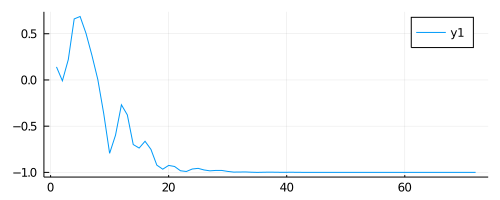

In [12]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

In [13]:
f(X_hist[end, :]...)

-0.9999998844353907

## Nesterov Accelerated Gradient

NAG modifies the momentum optimizer by evaluating the gradient of the function slightly ahead towards the direction of the momentum

In [14]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.05
# Play with 0.7, 0.8, 0.81
β = 0.8


convergence = false
m = ones(2)
while !convergence
    m = β * m + α * ∇f(X0 + β * m)
    X0 = X0 - m
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [15]:
f(X_hist[end, :]...)

-0.964870873405477

In [16]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

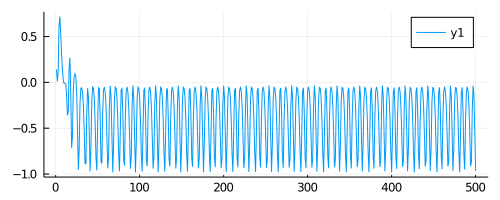

In [17]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## AdaGrad

$$
s := s + \nabla f(x) \odot \nabla f(x)\\
    x := x - \alpha \nabla f(x) \oslash \sqrt{s + \epsilon}
$$

In [18]:
X0 = [0, -0.1]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.05
ϵ = 1e-6

convergence = false
s = ones(2)
while !convergence
    s = s + ∇f(X0) .* ∇f(X0)
    X0 = X0 - α * ∇f(X0) ./ sqrt.(s .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [19]:
f(X_hist[end, :]...)

-0.8832772185159766

In [20]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

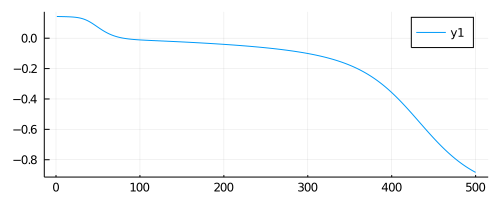

In [21]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## RMSProp

$$
s := \beta s + (1 - \beta) \nabla f(x) \odot \nabla f(x)\\
    x := x - \alpha \nabla f(x) \oslash \sqrt{s + \epsilon}
$$

In [22]:
X0 = [0, 0]
X0 = [0, -0.1]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.01
β = 0.3
ϵ = 1e-8

convergence = false
s = ones(2)
while !convergence
    s = β * s + (1 - β) * ∇f(X0) .* ∇f(X0)
    X0 = X0 - α * ∇f(X0) ./ sqrt.(s .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

┌ Warning: Procedure did not converge
└ @ Main In[3]:20


In [23]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

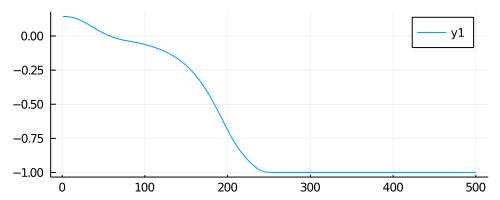

In [24]:
plot(map(X -> f(X[1], X[2]), eachrow(X_hist)), size=(500, 200))

## ADAM

$$
m := \beta_1 m + (1 - \beta_1) \nabla f(x)\\
s := \beta_2 s + (1 - \beta_2) \nabla f(x) \odot \nabla f(x)\\
$$

$$
\hat m := \frac{m}{1 - \beta_1^t} \\
    \hat s := \frac{s}{1 - \beta_2^t}
$$


$$
x := x - \alpha \hat m \oslash \sqrt{\hat s + \epsilon}
$$

In [63]:
X0 = [0, 0]
X_hist = X0[new, :]
maxit = 500
# Play with 0.01, 0.05
α = 0.05
β1 = 0.08
β2 = 0.9
ϵ = 1e-8

convergence = false
s = ones(2)
m = -ones(2)
while !convergence
    m = β1 * m + (1 - β1) * ∇f(X0)
    s = β2 * s + (1 - β2) * ∇f(X0) .* ∇f(X0)
    
    mhat = m / (1 - β1)
    shat = s / (1 - β2)
    
    X0 = X0 - α * mhat ./ sqrt.(shat .+ ϵ)
    
    X_hist = vcat(X_hist, X0[new, :])
    convergence = check_convergence(f, X_hist, maxit)
end

In [64]:
f(X_hist[end, :]...)

-0.9999999518472791

In [65]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
plot_path!(X_hist)

# An alternate method: swarm optimization

```
for each particle i = 1, ..., S do
    Initialize the particle's position with a uniformly distributed random vector: xi ~ U(blo, bup)
    Initialize the particle's best known position to its initial position: pi ← xi
    if f(pi) < f(g) then
        update the swarm's best known position: g ← pi
    Initialize the particle's velocity: vi ~ U(-|bup-blo|, |bup-blo|)
while a termination criterion is not met do:
    for each particle i = 1, ..., S do
        for each dimension d = 1, ..., n do
            Pick random numbers: rp, rg ~ U(0,1)
            Update the particle's velocity: vi,d ← ω vi,d + φp rp (pi,d-xi,d) + φg rg (gd-xi,d)
        Update the particle's position: xi ← xi + lr vi
        if f(xi) < f(pi) then
            Update the particle's best known position: pi ← xi
            if f(pi) < f(g) then
                Update the swarm's best known position: g ← pi
```

In [1070]:
# Best known position
g = [0., 0]
f(g...)

0.1411200080598672

In [1056]:
Random.seed!(314)
n_particles = 40
b_low, b_up = -4, 2
particles = b_low .+ (b_up - b_low) * rand(Float64, (n_particles, 2))
best_positions = particles[:, :];

In [1071]:
g

2-element Array{Float64,1}:
 0.0
 0.0

In [1063]:
typeof(particles)

Array{Float64,2}

In [1057]:
for position in eachrow(best_positions)
    if f(position...) < f(g...)
            println("Change of best position")
        g = position
    end
end

Change of best position
Change of best position


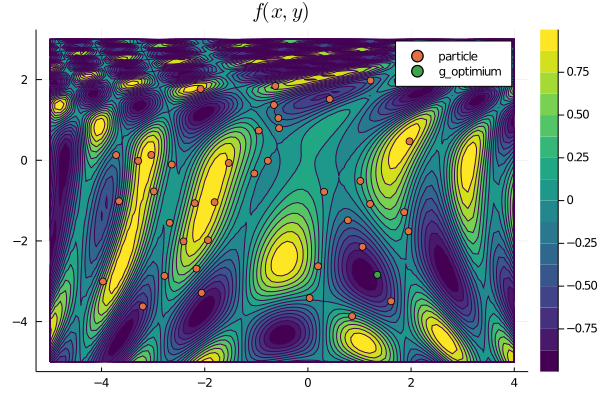

In [1061]:
contourf(xrange, yrange, Z, title=L"f(x,y)", c=:viridis)
scatter!(eachcol(best_positions)..., label="particle")
scatter!([g[1]], [g[2]], label="g_optimium")

In [1007]:
f(g...)

-0.8376006237511162

In [1008]:
v_init = abs(b_up - b_low)
velocity = -v_init .+ 2v_init * rand(Float64, (n_particles, 2));

In [1009]:
ω =0.7
ϕp = 0.1
ϕg = 0.1
lr = 0.5

0.5

In [1043]:
for n = 1:n_particles
    xn = particles[n, :]
    pn = best_positions[n, :]
    
    for d = 1:2
        xd = xn[d]
        pd = pn[d]
        rp = rand()
        rg = rand()
        gd = g[d]
        
        velocity[n, d] = ω * velocity[n, d] + ϕp * rp * (pd - xd) + ϕg * rg * (gd - xd)
    end
    
    x_new = particles[n, :] .+ lr * velocity[n, :]
    #println(sqrt(sum((xn - x_new) .^ 2)))
    particles[n, :] = x_new
    
    if f(x_new...) < f(pn...)
        #println(f(x_new...))
        best_positions[n, :] = x_new
        if f(x_new...) < f(g...)
            g = x_new
        end
    end
end

f(g...)

-0.995722139683665